In [55]:

import xml.etree.ElementTree as ET
import pandas as pd



import numpy as np
import matplotlib.pyplot as plt
from matplotlib.path import Path
from matplotlib.patches import PathPatch
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objects as go

%matplotlib inline
    
#%matplotlib notebook
    
#%matplotlib widget
    
import math 
import statistics

from ROOT import TCanvas, TH1F, TGraph, gROOT
from array import array


import pprint
import re


# 0. Input padplane mapping

In [56]:
#map='PadPlane/AutoPad-R1-RevA.sch'
#map='PadPlane/AutoPad-R2-RevA-Pads.sch'
#map='PadPlane/AutoPad-R3-RevA.sch'
maps = [ 
    '/Users/chenxi/developer/sphenix/tpc_sim/TPC_Toy_Model/PadPlane/AutoPad-R1-RevA.sch',
    '/Users/chenxi/developer/sphenix/tpc_sim/TPC_Toy_Model/PadPlane/AutoPad-R2-RevA-Pads.sch',
    '/Users/chenxi/developer/sphenix/tpc_sim/TPC_Toy_Model/PadPlane/AutoPad-R3-RevA.sch',
]

## Finding coordinates of pad centroids

Read .brd files to get polygons from the files and find centroids

Prepare functions for the reading:

In [57]:
def get_pad_coordinates(root):
    '''Reading all the vertices of the pads from the xml ElementTree '''

    all_elements = [elem.tag for elem in root.iter()]
    all_attributes = [elem.attrib for elem in root.iter()]
    i = 0
    f_vertex = False
    f_wire = False
    all_vertices = []
    vertex_array = []
    pad_names = []
    pad_name=''
    for ele in all_elements:
        #print(ele)
        if f_vertex :
            if ele == 'vertex':
                vertex_array.append(all_attributes[i])
            else:
                pad_names.append(pad_name)
                all_vertices.append(vertex_array)
                f_vertex = False
                f_wire = False
        if f_wire:
            if ele == 'wire' and all_attributes[i]['layer']=='16':
                vertex_array.append({'x':all_attributes[i]['x1'],'y':all_attributes[i]['y1']})
                vertex_array.append({'x':all_attributes[i]['x2'],'y':all_attributes[i]['y2']})
                #print()
            elif ele == 'signal':
                pad_names.append(pad_name)
                all_vertices.append(vertex_array)
                f_vertex = False
                f_wire = False
            
        if ele == 'signal':
            pad_name = all_attributes[i]['name']

        if ele == 'polygon':
            if all_attributes[i]['layer']=='16':
                #print(ele, all_attributes[i])
                f_vertex = True
                vertex_array = []
        if re.match(r"DC*", pad_name):
            #fDC = True
            if ele == 'signal':
                #if all_attributes[i]['layer']=='16':
                #print(ele, all_attributes[i])
                f_wire = True
                vertex_array = []

        i += 1

    return all_vertices, pad_names

In [58]:
colors = [
    "red",        # Red
    "blue",       # Blue
    "purple",     # Purple
    "darkgreen",  # Dark Green
    "darkred",    # Dark Red
    "gray",       # Gray
    "indigo"      # Indigo
]

In [59]:
tpc_x_sizes = [[-101, 101],[-151, 151],[-201, 201]]
tpc_y_sizes = [[300, 405],[395, 575],[560, 760]]
Nbins = [94, 128, 192]
tpc_adc_clock = 53.326184 # ns, for 18.8 MHz clock

In [60]:

def make_pad_graphs(all_vertices, all_PadNames, iter_module = 0):

    '''Creates polygons for pads'''

    # Run over all pad vertices  
    pads_xy = {
        'PadName':[],
        'PadX':[],
        'PadY':[],
        'PadR':[],
        'PadPhi':[],
        'PadN':[],
        'PadPath':[],
        'PadNumber':[]
    }
    fig, ax = plt.subplots(figsize=(30,30))
    
    iter = 0
    for vx_array, padName in zip(all_vertices,all_PadNames):
        iter+=1
        #if iter>100 : continue
        phi_min=100.0
        phi_max=-100.0
        x_vx = []
        y_vx = []
        r_vx = []
        phi_vx = []
        xy_vx = []
        layer_r_min =0
        layer_r_max =0
        layer_r_min_loc=0
        layer_r_max_loc =0
        #Each pad vertices are wrote down 
        for vx in vx_array:
            x_vx.append(float(vx['x']))
            y_vx.append(float(vx['y']))
            r = math.sqrt(float(vx['y'])**2+float(vx['x'])**2)
            phi = math.atan2(float(vx['y']),float(vx['x']))
            if phi<phi_min:
                phi_min=phi
            if phi>phi_max:
                phi_max=phi
            r_vx.append(r)
            phi_vx.append(phi)
            xy_vx.append([float(vx['x']),float(vx['y'])])
            #print(n_points, ": ", xy_vx[n_points])
            
        phi_vx.sort()
        phi_mins = phi_vx[:18]
        phi_maxs = phi_vx[-18:]
        new_phi_min =  sum(phi_mins) / len(phi_mins)
        new_phi_max =  sum(phi_maxs) / len(phi_maxs)
        #print(phi_min, new_phi_min, phi_max, new_phi_max )
        
        #Make Polygons
        xy_vx.append(xy_vx[0])  #Close the Polygon

        codes = [Path.MOVETO] + [Path.LINETO] * (len(xy_vx) - 2) + [Path.CLOSEPOLY]
        path = Path(xy_vx, codes)
        path_patch = PathPatch(path, facecolor = colors[iter%len(colors)], edgecolor = 'black', linewidth= 0.01)
        ax.add_patch(path_patch)
     
        
        #c_r = sum(r_vx) / len(r_vx)
        c_r = (min(r_vx) + max(r_vx))/2
        r_vx.sort()
        layer_r_min_loc+=min(r_vx)
        layer_r_max_loc+=max(r_vx)
        if ((iter - 1)%16 == 0): 
            layer_r_min = layer_r_min_loc/16
            layer_r_max = layer_r_max_loc/16
            layer_r_max_loc=0
            layer_r_min_loc=0
            
        #print("iter ",iter," layer ", (iter - 1)//16, " min r ", min(r_vx), "max r ",max(r_vx))
        r_vx = r_vx[2:-2]
        c_r = sum(r_vx) / len(r_vx)
        if ((iter - 1)%16 == 0): 
            thickness_low = c_r - layer_r_min
            thickness_hi = -c_r + layer_r_max
            #print(" layer ", (iter - 1)//16, " r ", c_r, " low ", thickness_low, " hi ", thickness_hi)

        c_phi = (new_phi_max + new_phi_min)/2
        c_x = c_r*math.cos(c_phi)
        c_y = c_r*math.sin(c_phi)
        
        pads_xy['PadName'] .append(padName)
        pads_xy['PadX'] .append(c_x)
        pads_xy['PadY'] .append(c_y)
        pads_xy['PadR'] .append(c_r)
        pads_xy['PadPhi'] .append(c_phi)
        pads_xy['PadN'] .append(len(vx_array))
        pads_xy['PadPath'] .append(path)
        pads_xy['PadNumber'] .append(iter)
        
       # plt.plot(c_x, c_y, 'o', color=colors[iter % len(colors)], label=f"Point {iter+1}")  # 'bo' is for blue color, 'o' is for a circular marker
        if len(pads_xy['PadPhi'])>16:
            dphi = (pads_xy['PadPhi'][len(pads_xy['PadPhi'])-16] - c_phi)/2.
            c_r1, c_r2 = 0.997*c_r, 1.003*c_r
            c_x0, c_x1, c_x2, c_x3 = c_r1*math.cos(c_phi-dphi), c_r1*math.cos(c_phi+dphi), c_r2*math.cos(c_phi+dphi), c_r2*math.cos(c_phi-dphi)
            c_y0, c_y1, c_y2, c_y3 = c_r1*math.sin(c_phi-dphi), c_r1*math.sin(c_phi+dphi), c_r2*math.sin(c_phi+dphi), c_r2*math.sin(c_phi-dphi)
            if False: plt.plot([c_x0,c_x1, c_x2, c_x3, c_x0], [c_y0,c_y1, c_y2, c_y3,c_y0], marker='', color='black'  , linewidth = 2)#color=colors[iter % len(colors)]
        #plt.draw() 
    
    ax.set_xlim(tpc_x_sizes[iter_module][0], tpc_x_sizes[iter_module][1])
    ax.set_ylim(tpc_y_sizes[iter_module][0], tpc_y_sizes[iter_module][1])


    #plt.show()
    phi_min=min(pads_xy['PadPhi'])
    phi_max=max(pads_xy['PadPhi'])
    
    #print(phi_min - np.pi/2, " < phi < ", phi_max - np.pi/2, "width=", phi_max-phi_min, " dphi=", abs(phi_max- np.pi/2) - abs(phi_min - np.pi/2))
    #print(phi_min, " < phi < ", phi_max, "width=", phi_max - phi_min, " bin width ", (phi_max - phi_min)/len(pads_xy['PadPhi']), " dphi=", abs(phi_max - np.pi/2) - abs(phi_min - np.pi/2))

    df = pd.DataFrame(data=pads_xy)

    df['PadR_group'] = df['PadR'].round(3)
    
    # Sort by the rounded PadR (ascending) and then by PadPhi (descending)
    df_sorted = df.sort_values(by=['PadR_group', 'PadPhi'], ascending=[True, False])
    
    # Enumerate rows within each PadR_group (starting from 1)
    #df_sorted['PadNumber'] = df_sorted.groupby('PadR_group').cumcount() + 1

    # Reset index so that we can number the rows continuously
    df_sorted = df_sorted.reset_index(drop=True)
    
    # Create a continuous numbering across all rows
    df_sorted['PadNumber'] = df_sorted.index + 1
    offset = -2
    for _, row in df_sorted.iterrows():
        if(row['PadX']<0):
            offset+=0.1
        else:
            offset-=0.1
        if(row['PadR']>310):
            ax.text(row['PadX'], row['PadY'], 
                str(row['PadNumber']),
                horizontalalignment='center', 
                verticalalignment='bottom', 
                fontsize=8, color='black')
    plt.show()
    #print(df_sorted[['PadR', 'PadR_group', 'PadPhi', 'PadNumber']])
    #print(max(df_sorted['PadPhi']), min(df_sorted['PadPhi']))
    return  df_sorted


## Draw zig-zags

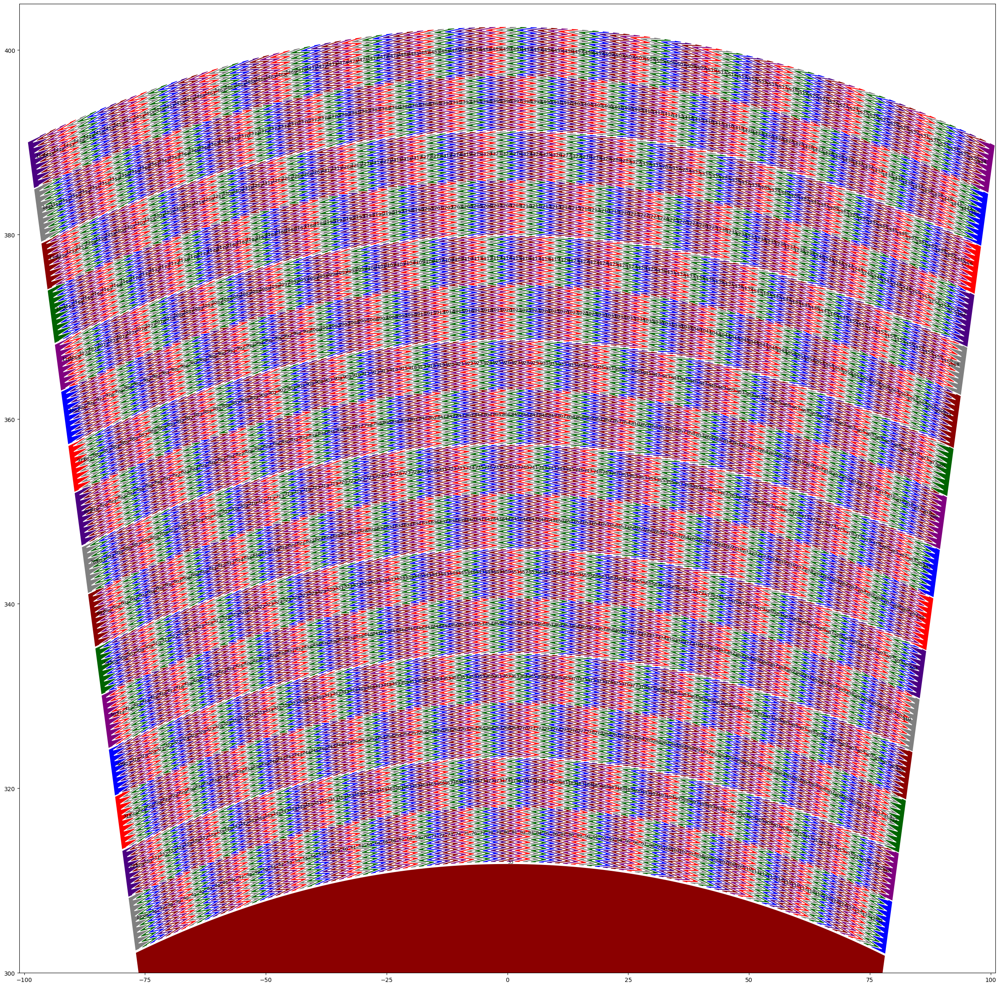

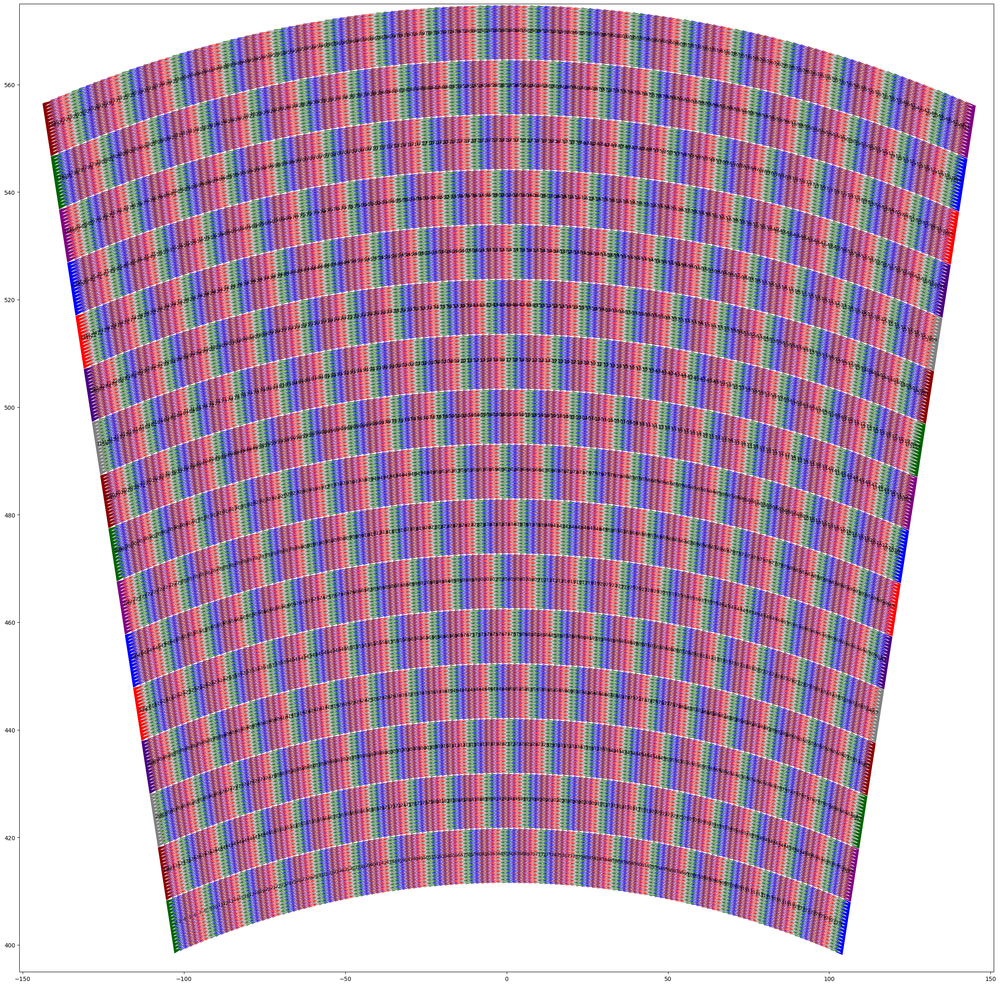

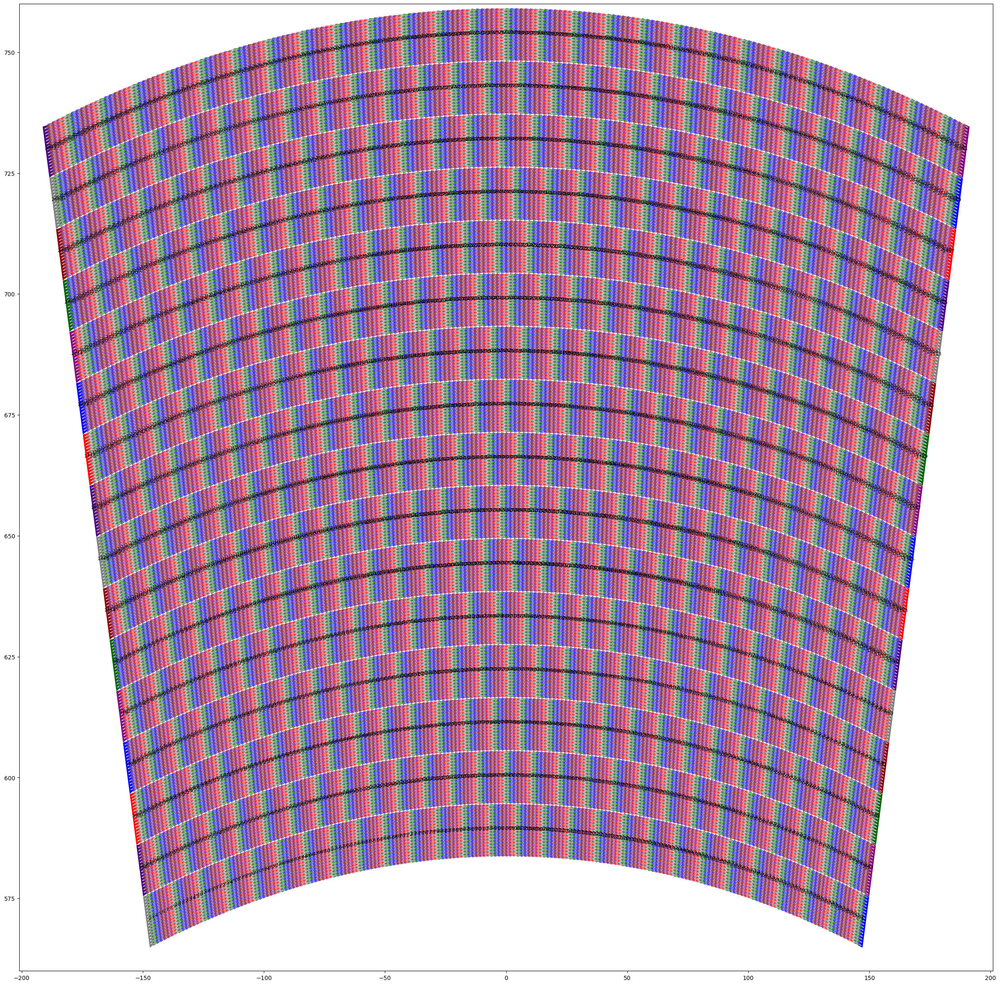

In [61]:
df_centroids = []
brd_maps = [
    '/Users/chenxi/developer/sphenix/tpc_sim/TPC_Toy_Model/PadPlane/AutoPad-R1-RevA.brd',
    '/Users/chenxi/developer/sphenix/tpc_sim/TPC_Toy_Model/PadPlane/AutoPad-R2-RevA-Pads.brd',
    '/Users/chenxi/developer/sphenix/tpc_sim/TPC_Toy_Model/PadPlane/AutoPad-R3-RevA.brd',
]
iter_module = 0
for brd_map in brd_maps:
    tree_R = ET.parse(brd_map)
    root_R = tree_R.getroot()
    # Get all pad vertices
    all_vertices_R, all_PadNames_R = get_pad_coordinates(tree_R)

    #Get centroids of the polygons
    df_centroids_R = make_pad_graphs(all_vertices_R, all_PadNames_R, iter_module)
    df_centroids.append(df_centroids_R)

    #plt.show()
    iter_module += 1


# 0. Draw Coordinates

In [62]:
# Parameters
num_circles = 4  # Number of concentric circles
num_sectors = 12  # Number of radial divisions (sectors)
inner_radius = 1  # Radius of the inner circle (to exclude the center)
rotation_offset = np.pi / num_sectors  # Half the angle of one sector
TpcLength = 105.5
module_radius = [31.105,40.249,41.153,57.475,58.367,75.911]
colors = ['tomato','c','green']
min_radii_module = [314.9836110818037, 416.59202613529567, 589.1096495597712]
max_radii_module = [399.85222874031024, 569.695373910603, 753.6667758418596]
delta_R_module = [5.630547309825637, 5.6891770257002054, 10.206889851687158, 10.970475085472556]
left_phi_module = [ 1.814070180963218, 1.8196038006425466, 1.8231920135309803]
right_phi_module = [ 1.3233741362052793, 1.3190806892129499, 1.3183480511410641]

In [63]:

def draw_coordinates():
    fig = plt.figure(figsize=(30, 30))  # Adjust figure size (10x5 is a more typical size)
    # Add polar subplots
    ax1 = fig.add_subplot(121, polar=True)  # 1 row, 2 columns, 1st subplot
    #ax2 = fig.add_subplot(122, polar=True) 
    #(ax1,ax2) = plt.subplot(111, polar=True)

    # Draw concentric circles
    circle_radii = np.linspace(inner_radius, inner_radius + num_circles - 1, num_circles)
    for radius in module_radius:
        ax1.plot(np.linspace(0, 2 * np.pi, 100), [radius] * 100, color='black')
        #ax2.plot(np.linspace(0, 2 * np.pi, 100), [radius] * 100, color='black')

    # Draw radial lines with rotation offset
    angles = np.linspace(0, 2 * np.pi, num_sectors, endpoint=False) + rotation_offset
    for angle in angles:
        ax1.plot([angle, angle], [module_radius[0], module_radius[5]], color='black')
       # ax2.plot([angle, angle], [module_radius[0], module_radius[5]], color='black')

    ax1.set_ylim(0, module_radius[5]+5)
    #ax1.axis('off')  # Turn off the axis

    # Return the figure and axes so that we can overlay additional plots
    return fig, ax1#, ax2

In [64]:
def DrawPadPlaneScheme(fig, side):
    if side ==0:
        sidecolor = 'red'
        z_side = TpcLength
    else:
        sidecolor = 'blue'
        z_side = -TpcLength
        
    theta_vals = np.linspace(0, 2 * np.pi, 100)
    for radius in module_radius:
        # Convert polar to Cartesian coordinates
        x = radius * np.cos(theta_vals)
        y = radius * np.sin(theta_vals)
        z = np.full_like(x, z_side)  # Set z to 0 (modify if needed)
        fig.add_trace(go.Scatter3d(x=z, y=x,  z=y, mode='lines', line=dict(color=sidecolor), showlegend=False))
   

    
    # Draw radial lines with rotation offset
    angles = np.linspace(0, 2 * np.pi, num_sectors, endpoint=False) + rotation_offset
    for angle in angles:
        # Create a line from the smallest to the largest radius
        r_line = np.linspace(module_radius[0], module_radius[-1], 100)
        x_line = r_line * np.cos(angle)
        y_line = r_line * np.sin(angle)
        z_line = np.full_like(x_line, z_side)  # Set z to 0 (modify if needed)
        fig.add_trace(go.Scatter3d(x=z_line, y=x_line,z=y_line,  mode='lines', line=dict(color=sidecolor), showlegend=False))


In [65]:
def DrawMembrane(fig):
    resolution = 100
    theta_vals = np.linspace(0, 2 * np.pi, 100)
    r = np.linspace(0, module_radius[-1], resolution)  # Radial values
    theta_grid, r_grid = np.meshgrid(theta_vals, r)  
    x = r_grid * np.cos(theta_grid)
    y = r_grid * np.sin(theta_grid)
    z = np.full_like(x, 0) 
    fig.add_trace(go.Surface(x=z, y=x,  z=y, surfacecolor=np.ones_like(x),   colorscale=[[0, 'grey'], [1, 'grey']],  opacity=0.3))


In [66]:
def draw_coordinates_3d():
    # Example parameters (replace these with your actual values)

    # Create a figure
    fig = go.Figure()
    theta_vals = np.linspace(0, 2 * np.pi, 100)
    DrawPadPlaneScheme(fig, 0)
    DrawPadPlaneScheme(fig, 1)
    DrawMembrane(fig)

    z_TPC = np.linspace(-TpcLength, TpcLength, 100)  # Z values
    # Create a grid of theta and z values
    theta_grid, z_grid = np.meshgrid(theta_vals, z_TPC)
    
    # Convert polar coordinates to Cartesian coordinates
    x_outer_surf = module_radius[-1] * np.cos(theta_grid)
    y_outer_surf = module_radius[-1] * np.sin(theta_grid)

    fig.add_trace(go.Surface(x=z_grid , y=x_outer_surf, z=y_outer_surf, opacity=0.3))

    x_inner_surf = module_radius[0] * np.cos(theta_grid)
    y_inner_surf = module_radius[0] * np.sin(theta_grid)

    fig.add_trace(go.Surface(x=z_grid , y=x_inner_surf, z=y_inner_surf, opacity=0.3))
    
    # Set layout for the plot
    fig.update_layout(
        scene=dict(
            xaxis=dict(title='Z', range=[-TpcLength-5, TpcLength+5]),
            yaxis=dict(title='X', range=[-module_radius[-1]-5, module_radius[-1]+5]),
            zaxis=dict(title='Y', range=[-module_radius[-1]-5, module_radius[-1]+5]),
            aspectmode='manual',
            aspectratio=dict(x=2, y=1, z=1)
        ),
        margin=dict(l=0, r=0, b=0, t=0),
        width=600,
        height=600
    )

    return fig



In [67]:
def draw_ideal_track(fig, track):
  
    x_ideal = track['x']
    y_ideal = track['y']
    z_ideal = track['z']
    #print(x_ideal,y_ideal,z_ideal)

    fig.add_trace(go.Scatter3d(x=z_ideal, y=x_ideal, z=y_ideal,  mode='lines', marker=dict(color='red', size =1), showlegend=False))
    
    #ax.legend()

In [68]:
def draw_PI_track(fig, track):
  
    x_el = track['x']
    y_el = track['y']
    z_el = track['z']
    #print(x_ideal,y_ideal,z_ideal)

    fig.add_trace(go.Scatter3d(x=z_el, y=x_el, z=y_el,  mode='markers', marker=dict(color='green', size =2), showlegend=False))
    
    #ax.legend()

In [69]:
def draw_final_track(fig, track):
  
    x_fi = track['x']
    y_fi = track['y']
    z_fi = track['z']
    #print(x_ideal,y_ideal,z_ideal)

    fig.add_trace(go.Scatter3d(x=z_fi, y=x_fi, z=y_fi,  mode='lines', marker=dict(color='blue', size =2), showlegend=False))
    
    #ax.legend()

In [70]:
def draw_reconstructed_track(fig, track_reco, vdrift):
    maxdriftlength = 105.5 # cm
    x_fi = track_reco['x']
    y_fi = track_reco['y']
    t_fi = track_reco['time']
    z_fi = maxdriftlength - t_fi*vdrift
    #print(x_ideal,y_ideal,z_ideal)

    fig.add_trace(go.Scatter3d(x=z_fi, y=x_fi, z=y_fi,  mode='lines', marker=dict(color='blue', size =2), showlegend=False))

# 1.Simulate track and primary ionization

In [71]:
def simulate_electron_track(p=1.0, m=0.134, q=-1, phi = np.pi/4, theta = np.pi/3, B_field=1.4, sigma_xy=0.005, sigma_z=0.005, vertex=(0,0,0)):

    
    # Unpack vertex coordinates
    pz = p * np.cos(theta)
    pt = p * np.sin(theta)
    x0, y0, z0 = vertex
    #print("pz ", pz," pt ", pt)
    
    # Calculate the track curvature radius in the transverse plane:
    R_track = 100 * pt / (abs(q) * 0.3 * B_field) #in cm
    omega = (q * 0.3 * B_field)/m
    print("R ", R_track, " omega ", omega)
    #mask = (R_track_full < module_radius[5]+5) 
    #print(R_track_full)
    #R_track = R_track_full[mask]
    #print(R_track)


    # Define max angle phi_max based on radius cutoff at 76 cm
    if R_track > (module_radius[5]-50)/2:
        phi_max = np.arccos(((module_radius[5]-50)/2 - R_track) / R_track)  # Stop before leaving r=76
      #  print(f" R_track > (module_radius[5]-50)/2: {phi_max}")
    else:
        phi_max = 2*np.pi   
        #print(f" : {phi_max}")
    
    # Compute t_final
    t_final = phi_max / omega  
    #t_final = 0.5
   
    
    # Define timestamps based on arc length spacing (e.g., Δs = 1 cm per step)
    delta_s = 1  # cm per step
    timestamps = int((R_track * phi_max) / delta_s)

    t = np.linspace(0, t_final, timestamps)

    # Create an array of angles to parameterize the circular motion in the x-y plane.

    phi = phi - np.sign(q) * np.pi/2
    vz = pz / m
   # print("vz ",vz)
    
    # Ideal track coordinates (circle in x-y and linear in z)
    x_ideal = x0 - (R_track) * np.cos(phi) + R_track * np.cos(phi + omega * t)
    y_ideal = y0 - (R_track) * np.sin(phi) + R_track * np.sin(phi + omega * t)

    #v = R_track * omega / np.sin(theta)
    z_ideal = z0 + 100*(vz ) * t
    '''
    mask = (x_ideal < 65/2) & (y_ideal < 65/2) 
    # Apply mask
    x_ideal_masked = x_ideal[mask]
    y_ideal_masked = y_ideal[mask]
    z_ideal_masked = z_ideal[mask]
    #z_ideal = z0 + np.linspace(0, 100.0, timestamps)  # z increases linearly from the vertex
    '''
    # Add Gaussian noise to simulate TPC measurement uncertainties
    x_meas = x_ideal + np.random.normal(0, sigma_xy, timestamps)
    y_meas = y_ideal + np.random.normal(0, sigma_xy, timestamps)
    z_meas = z_ideal + np.random.normal(0, sigma_z, timestamps)


    return {
        'x': x_ideal, 'y': y_ideal, 'z': z_ideal
    }
    


In [72]:
def calculate_start_end(track):
    x_ideal = track['x']
    y_ideal = track['y']
    z_ideal = track['z']
    r1 = min_radii_module[0]/10
    r2 = max_radii_module[-1]/10
    #print(r1,r2)
    R_ideal = np.sqrt(x_ideal**2 + y_ideal**2)
    #print(x_ideal, y_ideal)
    idx_closest_1 = np.argmin(np.abs(R_ideal - r1))
    idx_closest_2 = np.argmin(np.abs(R_ideal - r2))

    # Ensure correct direction
    if idx_closest_1 > idx_closest_2:
        idx_closest_1, idx_closest_2 = idx_closest_2, idx_closest_1

    # Slice the segment between the two indices
    x_seg = x_ideal[idx_closest_1:idx_closest_2 + 1]
    y_seg = y_ideal[idx_closest_1:idx_closest_2 + 1]
    z_seg = z_ideal[idx_closest_1:idx_closest_2 + 1]

    # Compute curve length (sum of 3D distances between consecutive points)
    dx = np.diff(x_seg)
    dy = np.diff(y_seg)
    dz = np.diff(z_seg)
    segment_lengths = np.sqrt(dx**2 + dy**2 + dz**2)
    arc_length = np.sum(segment_lengths)
    # Straight-line (direct) length
    dx_total = x_ideal[idx_closest_2] - x_ideal[idx_closest_1]
    dy_total = y_ideal[idx_closest_2] - y_ideal[idx_closest_1]
    dz_total = z_ideal[idx_closest_2] - z_ideal[idx_closest_1]
    straight_length = np.sqrt(dx_total**2 + dy_total**2 + dz_total**2)
    
    return {
        'xi': x_ideal[idx_closest_1],
        'yi': y_ideal[idx_closest_1],
        'zi': z_ideal[idx_closest_1],
        'xf': x_ideal[idx_closest_2],
        'yf': y_ideal[idx_closest_2],
        'zf': z_ideal[idx_closest_2],
        'length': arc_length,
        'straight_length': straight_length
    }
    #print(result)
    #return result

In [73]:
def calculate_PI(track_length = 753.6667758418596 - 314.9836110818037):
    gas = ["Ar", "CF4", "Iso"]
    Np = [23, 51, 84] #Ar, CF4, Iso
    Nt = [94, 100, 195]
    frac = [0.75, 0.20, 0.05]
    Ntot = 0
   
    for igas in range(3):
        alpha = (Nt[igas] - Np[igas]) / Np[igas] if Np[igas] != 0 else 0
        total_electrons = 0
        mean_primary = Np[igas] * track_length
        # Sample primary electrons using a Poisson distribution.
        primary_count = np.random.poisson(mean_primary)
        total_electrons += primary_count
    
        # For each primary electron, sample the number of secondary electrons.
        for _ in range(primary_count):
            secondary_count = np.random.poisson(alpha)
            total_electrons += secondary_count
        print("Number of electrons produced in ", gas[igas], " = ", total_electrons)
        Ntot += total_electrons*frac[igas]
        
    print("Total electrons produced in TPC volume:", Ntot)
    return Ntot

In [74]:
def sample_along_track(track,  N):
    x_ideal = track['x']
    y_ideal = track['y']
    z_ideal = track['z']
    r1 = min_radii_module[0]/10
    r2 = max_radii_module[-1]/10
    print(r1,r2)
    R_ideal = np.sqrt(x_ideal**2 + y_ideal**2)
    #print(x_ideal, y_ideal)
    idx_closest_1 = np.argmin(np.abs(R_ideal - r1))
    idx_closest_2 = np.argmin(np.abs(R_ideal - r2))
    # Ensure idx1 < idx2
    if idx_closest_1 > idx_closest_2:
        idx_closest_1, idx_closest_2 = idx_closest_2, idx_closest_1

    x_seg = track['x'][idx_closest_1:idx_closest_2 + 1]
    y_seg = track['y'][idx_closest_1:idx_closest_2 + 1]
    z_seg = track['z'][idx_closest_1:idx_closest_2 + 1]

    # Compute cumulative arc length along the curve
    dx = np.diff(x_seg)
    dy = np.diff(y_seg)
    dz = np.diff(z_seg)
    segment_lengths = np.sqrt(dx**2 + dy**2 + dz**2)
    arc_dist = np.concatenate([[0], np.cumsum(segment_lengths)])  # len = len(x_seg)

    # Sample N uniform points along the arc length
    total_length = arc_dist[-1]
    sampled_distances = np.sort(np.random.uniform(0, total_length, N))

    # Interpolate x, y, z along arc
    x_sampled = np.interp(sampled_distances, arc_dist, x_seg)
    y_sampled = np.interp(sampled_distances, arc_dist, y_seg)
    z_sampled = np.interp(sampled_distances, arc_dist, z_seg)

    return {'x': x_sampled, 'y': y_sampled, 'z': z_sampled}


## Draw primary electrons

In [75]:
fig = draw_coordinates_3d()


# 2. Simulate one electron track using your function.
track = simulate_electron_track(p=1,  q=-1, phi = np.pi/2, theta = 3*np.pi/4, vertex=(0, 0, 0))


# 3. Overlay the simulated electron track on one of the polar subplots (e.g., ax1).
draw_ideal_track(fig, track)

sf = calculate_start_end(track)
length = sf['length']
N = int(calculate_PI(length))
PI = sample_along_track(track, N)
#print(PI['z_ideal'])
draw_PI_track(fig, PI)

# Display the final plot.
#fig.show()

R  168.35875742536848  omega  -3.134328358208955
Number of electrons produced in  Ar  =  5855
Number of electrons produced in  CF4  =  6323
Number of electrons produced in  Iso  =  12665
Total electrons produced in TPC volume: 6289.1
31.49836110818037 75.36667758418596


# 2. Electron Drift

<img src="/Users/mitrankova/Jupyter/Gas_ElectronDrift.png" alt="Drift diagram" width="500"/>

In [76]:
maxdriftlength = 105.5 # cm
extended_readout_time = 0.0
pp_extended_readout_time = 7000.0;  # ns - Is used in coresoftware simulation
reco_tpc_maxtime_sample = 425
reco_tpc_time_presample = 40;  # 120 - 80
v_drift = 8.0e-3;  # cm/ns


  double ArCF4Isobutane_drift_velocity = 0.00755;

  double ArCF4Isobutane_diffusion_long = 0.014596;

  double ArCF4Isobutane_diffusion_trans = 0.005313;

  double ArCF4Isobutane_Ne_frac = 0.0;

  double ArCF4Isobutane_Ar_frac = 0.75;

  double ArCF4Isobutane_CF4_frac = 0.20;

  double ArCF4Isobutane_N2_frac = 0.00;
  
  double ArCF4Isobutane_isobutane_frac = 0.05;


In [77]:
def electron_derift(track):
    x0 = track['x']
    y0 = track['y']
    z0 = track['z']
    E = 400  # electric field in V/cm
    dz_cm = abs(z0 - TpcLength) #* 10000  # drift distance in µm (i.e. 1 cm)
 # drift velocity in µm/ns
    D_T = 175  # transverse diffusion in µm/√cm
    D_L = 230  # longitudinal diffusion in µm/√cm
    
    # Convert dz to cm for diffusion calculation
    #dz_cm = dz / 1e4
    
    # Compute diffusion sigmas
    sigma_T = D_T * np.sqrt(dz_cm)
    sigma_L = D_L * np.sqrt(dz_cm)
    
    # Random Gaussian shifts
    delta_x = np.random.normal(0, sigma_T)
    delta_y = np.random.normal(0, sigma_T)
    delta_z = np.random.normal(0, sigma_L)
    
    # Final position
    xf = x0 + delta_x / 1e4
    yf = y0 + delta_y / 1e4
    zf = np.linspace(TpcLength, TpcLength, x0.size)
    #zf = TpcLength + delta_z / 1e4
    drift_time= (dz_cm + delta_z / 1e4)/ v_drift
    
    return {'x': xf, 'y': yf, 'z': zf, 'time': drift_time}


In [78]:
fig = draw_coordinates_3d()


# 2. Simulate one electron track using your function.
track = simulate_electron_track(p=1,  q=-1, phi = np.pi/2, theta = 3*np.pi/4, vertex=(0, 0, 0))


# 3. Overlay the simulated electron track on one of the polar subplots (e.g., ax1).
draw_ideal_track(fig, track)

sf = calculate_start_end(track)
length = sf['length']
N = int(calculate_PI(length))
PI = sample_along_track(track, N)
draw_PI_track(fig, PI)

fi_pos = electron_derift(PI)
print(fi_pos)
draw_final_track(fig, fi_pos)
draw_reconstructed_track(fig, fi_pos, v_drift)

# Display the final plot.
#fig.show()

R  168.35875742536848  omega  -3.134328358208955
Number of electrons produced in  Ar  =  6284
Number of electrons produced in  CF4  =  6236
Number of electrons produced in  Iso  =  12297
Total electrons produced in TPC volume: 6575.05
31.49836110818037 75.36667758418596
{'x': array([ 2.8421119 ,  2.69269021,  2.98206349, ..., 16.93626999,
       17.05438288, 16.93630866]), 'y': array([-30.99086808, -31.00351708, -30.74867311, ..., -73.73179727,
       -73.77268694, -73.66929087]), 'z': array([105.5, 105.5, 105.5, ..., 105.5, 105.5, 105.5]), 'time': array([9279.23878536, 9322.76893646, 9269.50429059, ..., 3662.85585345,
       3651.82642334, 3668.38375546])}


# 3. GEM electron cloud

<img src="/Users/mitrankova/Jupyter/e_cloud.png" alt="Drift diagram" width="500"/>

In [79]:
#cloud_r = 0.15*2
cloud_r = 0.15 # cm Different gas mixture cloud_r = sqrt(geometry(=holes misalignment)^2 + physics_processes^2), Geometry is the same, how different the physics is..
Gain = 1400 #set_default_double_param("gem_amplification", 1400); PHG4TpcPadPlaneReadout.cc

# From coresoftware
gem_cloud_sigma = 0.04 # set_default_double_param("gem_cloud_sigma", 0.04);     // cm = 400 microns
sampa_shaping_lead = 32.0 #  set_default_double_param("sampa_shaping_lead", 32.0);  // ns, for 80 ns SAMPA
sampa_shaping_tail = 48.0#  set_default_double_param("sampa_shaping_tail", 48.0);  // ns, for 80 ns SAMPA
'''
  GEM Gain : 
  hp (2020/09/04): gain changed from 2000 to 1400, to accomodate gas mixture change
  from Ne/CF4 90/10 to Ne/CF4 50/50, and keep the average charge per particle per pad constant
'''
#/cvmfs/sphenix.sdcc.bnl.gov/alma9.2-gcc-14.2.0/release/release_new/new.6/share/calibrations/TPC/GainMaps/TPCGainMaps.root


'\n  GEM Gain : \n  hp (2020/09/04): gain changed from 2000 to 1400, to accomodate gas mixture change\n  from Ne/CF4 90/10 to Ne/CF4 50/50, and keep the average charge per particle per pad constant\n'

Use gaussian distribution of charge in integrated_density_of_circle_and_pad

In [80]:
# Simulate the Polya-distributed gain
def polya_gain(mean_gain):
    theta=0.8
    shape = 1 + theta
    scale = mean_gain / shape
    return np.random.gamma(shape, scale)

In [81]:
def exponential_gain(mean_gain):
    return np.random.exponential(scale=mean_gain)

# 4. Find pads

In [82]:
NSectors = 12
min_radii_module = [314.9836110818037, 416.59202613529567, 589.1096495597712]
max_radii_module = [399.85222874031024, 569.695373910603, 753.6667758418596]
delta_R_module = [5.630547309825637, 5.6891770257002054, 10.206889851687158, 10.970475085472556]
left_phi_module = [ 1.814070180963218, 1.8196038006425466, 1.8231920135309803]
right_phi_module = [ 1.3233741362052793, 1.3190806892129499, 1.3183480511410641]

In [83]:
def to_initial_sector(track):
    
    x0_raw = np.asarray(track['x'])
    y0_raw = np.asarray(track['y'])
    z0_raw = np.asarray(track['z'])

    R_raw = np.sqrt(x0_raw**2 + y0_raw**2)
    #print("x raw:", x0_raw)
    #print("Max R_raw:", R_raw.max(), "Limit:", max_radii_module[2])

    mask = (R_raw < max_radii_module[2]/10)
    #print("Mask:", mask)

    x0 = x0_raw[mask]
    y0 = y0_raw[mask]
    z0 = z0_raw[mask]

    #print("x after mask:", x0)

    R = R_raw[mask]
    phi = np.arctan2(y0, x0)

    side = 1 if np.all(z0 < 0) else 0
    pie = np.pi / NSectors
    sector = abs((phi - 2*np.pi/6) // pie).astype(int)
    phi_shift = np.pi - (sector + 2) * np.pi/6
    phi = phi - phi_shift

    x_new = R * np.cos(phi)
    y_new = R * np.sin(phi)

    return {'x': x_new, 'y': y_new, 'z': z0, 'sector': sector, 'side': side}


In [84]:
x0_cm, y0_cm, z0_cm = 35.0, 10.0, 50.0

# build the minimal “track” dict (units must be cm here)
track = {
    'x': [x0_cm],
    'y': [y0_cm],
    'z': [z0_cm]
}


# call your function
result = to_initial_sector(track)

# pull out the rotated point, sector index and side
x_new  = result['x'][0]   # in cm, after rotation into your loaded wedge
y_new  = result['y'][0]
sector = result['sector'][0]
side   = result['side']   # this is a scalar 0 or 1

print(f"Original (x,y,z) = ({x0_cm:.1f}, {y0_cm:.1f}, {z0_cm:.1f}) cm")
print(f" → Rotated into wedge coords: x_new = {x_new:.3f} cm, y_new = {y_new:.3f} cm")
print(f" → Global sector = {sector}, side = {side}")

Original (x,y,z) = (35.0, 10.0, 50.0) cm
 → Rotated into wedge coords: x_new = 35.311 cm, y_new = -8.840 cm
 → Global sector = 3, side = 0


In [ ]:
def to_initial_sector_p(x0, y0):


    R_raw = np.sqrt(x0**2 + y0**2)
    mask = (R_raw < max_radii_module[2])
    R = R_raw[mask]
    phi = np.arctan2(y0, x0)
    #phi += np.pi/2

    side = 0
    pie = np.pi/NSectors
    sector = abs((phi - 2*np.pi/6) // pie).astype(int)
    print(sector)

    phi_shift = np.pi  - (sector + 2) * np.pi/6

    phi = phi - phi_shift
    print(f"phi_shift {phi_shift}")
    x_new = R * np.cos(phi)
    y_new = R * np.sin(phi)
    #print("Initial")
    #print(phi, phi_shift, x0, y0, x_new, y_new)


    return {'x': x_new, 'y': y_new}

In [ ]:
def which_layer(r):
    module = -1
    layer = -1
    for imodule in range(3):
        if(r >= min_radii_module[imodule] and r < max_radii_module[imodule]):
            module = imodule
    Nlayers = 16
    
    if (module == 0):    
        for iraw in range(0, Nlayers):
            radius = 0
            n_pads_small = int((iraw+1)/2)
            n_pads_large = int(iraw/2)
            radius = min_radii_module[module]+delta_R_module[module]*n_pads_small+delta_R_module[module+1]*n_pads_large
            if( r > radius and r < radius + delta_R_module[module + (iraw % 2)]):
                layer = iraw
        
    if module > 0:
        for iraw in range(0, Nlayers):
            radius = 0
            radius = min_radii_module[module]+delta_R_module[module+1]*iraw
            if( r > radius and r < radius + delta_R_module[module + 1]):
                layer = iraw
        
    return module, layer

In [ ]:
def find_pad_for_point(x, y, df):
    """
    Given x, y coordinates and a DataFrame of pads with 'path' Path objects,
    return the PadName of the path that contains the point (if any).
    """
    point = (x, y)
    for _, row in df.iterrows():
        pad_path = row['PadPath']
        if pad_path.contains_point(point):
            return row['PadNumber']
    return None  # The point is not in any pad

In [ ]:
def edge_pads_hit(hit_x, hit_y, cloud_r, df, find_pad_for_point, num_points=20):
    hit_pads = set()
    
    # Generate angles evenly spaced around the circle
    angles = np.linspace(0, 2 * np.pi, num_points, endpoint=False)
    
    # For each angle, calculate the corresponding point on the circumference
    for theta in angles:
        x = hit_x + cloud_r * np.cos(theta)
        y = hit_y + cloud_r * np.sin(theta)
        pad = find_pad_for_point(x, y, df)
        if pad is not None:
            hit_pads.add(pad)
    
    return list(hit_pads)

In [ ]:

from shapely.geometry import Point, Polygon
def common_area_of_circle_and_pad(hit_x, hit_y, sigma, pad_path, circle_resolution=256):

    # If pad_path is a Path object, extract its vertices.
    if hasattr(pad_path, "vertices"):
        pad_coords = pad_path.vertices
    else:
        pad_coords = pad_path

    # Create the circle as a buffered point.
    circle = Point(hit_x, hit_y).buffer(sigma, resolution=circle_resolution)
    # Create the pad polygon from the coordinate sequence.
    pad = Polygon(pad_coords)
    if not pad.is_valid:
        pad = pad.buffer(0)
    if not circle.is_valid:
        circle = circle.buffer(0)
    # Compute and return the area of the intersection.
    intersection = circle.intersection(pad)
    return intersection

In [ ]:
#Goes through all pads of the hit
def hit_area(px, py,fig):
    
    #px = px*10
    #py = py*10
    r = np.sqrt(px**2 + py**2)
    module = 0
    #r = r*10
    module, layer = which_layer(r)
    #print(px, py, r, module)
    df = df_centroids[module]
    pad_name = find_pad_for_point(px, py, df)

    
    hit_pads = edge_pads_hit(px, py, cloud_r, df, find_pad_for_point,num_points=200)
    #print(hit_pads) 

    for index in hit_pads:
        pad_path_from_df = df.loc[df['PadNumber'] == index, 'PadPath'].iloc[0]

        path_patch = PathPatch(pad_path_from_df,  edgecolor = 'black', linewidth= 0.01)
        #ax.add_patch(path_patch)
        
        x_pad, y_pad = pad_path_from_df.vertices.T

        # Ensure it's closed (first point == last point)
        if x_pad[0] != x_pad[-1] or y_pad[0] != y_pad[-1]:
            x_pad = list(x_pad) + [x_pad[0]]
            y_pad = list(y_pad) + [y_pad[0]]
        else:
            x_pad = list(x_pad)
            y_pad = list(y_pad)

        # Add to figure
        fig.add_trace(go.Scatter(
            x=x_pad,
            y=y_pad,
            mode='lines',
            fill='toself',
            fillcolor='rgba(112,82,142,0.3)',
            line=dict(color='grey'),
            name='pad boundary',
            showlegend=False
        ))

        intersection = common_area_of_circle_and_pad(px, py, cloud_r, pad_path_from_df)
        
        '''
        if not intersection.is_empty:
            if intersection.geom_type == 'Polygon':
                x_hitpad, y_hitpad = intersection.exterior.xy
                ax.fill(x_hitpad, y_hitpad, color='red', alpha=0.5)
            elif intersection.geom_type == 'MultiPolygon':
                for geom in intersection.geoms:
                    x_hitpad, y_hitpad = geom.exterior.xy
                    ax.fill(x_hitpad, y_hitpad, color='red', alpha=0.5)
                    
        '''
        if intersection and not intersection.is_empty:
            if intersection.geom_type == 'Polygon':
                x_hitpad, y_hitpad = intersection.exterior.xy
                
                fig.add_trace(go.Scatter(
                    x=list(x_hitpad), y=list(y_hitpad),
                    mode='lines',
                    line=dict(color='red'),
                    fill='toself',
                    fillcolor='rgba(255,0,0,0.5)',
                    showlegend=False
                ))
            elif intersection.geom_type == 'MultiPolygon':
                for geom in intersection.geoms:
                    x_hitpad, y_hitpad = geom.exterior.xy
                    
                    fig.add_trace(go.Scatter(
                        x=list(x_hitpad), y=list(y_hitpad),
                        mode='lines',
                        line=dict(color='red'),
                        fill='toself',
                        fillcolor='rgba(255,0,0,0.5)',
                        showlegend=False
                    ))

        #area = intersection.area
        #integrated_value = integrated_density_of_circle_and_pad(px, py, cloud_r, pad_path_from_df)
    
    #ax.set_xlim(tpc_x_sizes[module][0], tpc_x_sizes[module][1])
    #ax.set_ylim(tpc_y_sizes[module][0], tpc_y_sizes[module][1])
    #ax.set_aspect('equal', adjustable='datalim')  # Other options: 'auto', a number like 2 (height is 2x width), etc.'
    
    #
    #phi_min=min(pads_xy['PadPhi'])
    #phi_max=max(pads_xy['PadPhi'])
    #plt.show()
    #fig.canvas.draw()
    #plt.pause(0.01) 
    #return integrated_value

In [ ]:
import plotly.express as px
import pandas as pd
def draw_all_hits(start_point, stop_point, track, fi_pos_i):

    x_ideal = track['x']*10
    y_ideal = track['y']*10

    x_fi = fi_pos_i['x']*10
    y_fi = fi_pos_i['y']*10
    x_list = fi_pos_i['x'][start_point:stop_point]*10
    y_list = fi_pos_i['y'][start_point:stop_point]*10
    sector = fi_pos_i['sector']



    '''
    #plt.ion()
    fig, ax = plt.subplots(figsize=(30, 30))

    ax.set_aspect('equal', adjustable='datalim')
      
    ax.scatter(x_fi, y_fi, color='Green', s=10, alpha=1, label='Final')
    ax.scatter(x_ideal, y_ideal, color='Blue', s=10, alpha=1, label='Ideal')

    for x, y in zip(x_list, y_list):
       hit_area(x, y, ax, fig)
    '''
    
    

    #df = pd.DataFrame({'x_fi': x_fi, 'y_fi': y_fi})
    #fig = px.scatter(df, x='x_fi', y='y_fi', width=800, height=800 )

      # Customize marker style
    print("=============================================")
    fig = go.Figure()

    fig.update_layout(
    scene=dict(
        xaxis=dict(title='X', range=[-module_radius[-1]-5, module_radius[-1]+5]),
        yaxis=dict(title='Y', range=[-module_radius[-1]-5, module_radius[-1]+5]),
        aspectmode='manual',
        aspectratio=dict(x=2, y=1, z=1)
    ),
    margin=dict(l=0, r=0, b=0, t=0),
    width=600,
    height=600
    )

    fig.add_trace(go.Scatter(x=x_fi, y=y_fi,  mode='markers', marker=dict(color='blue', size =2), showlegend=False))


    for x, y in zip(x_list, y_list):
       hit_area(x, y, fig)
    fig.add_trace(go.Scatter(x=x_list, y=y_list,  mode='markers', marker=dict(color='green', size =4), showlegend=False))

    fig.show()

    print(f"SECTOR : {sector}")
    print("=============================================")
    #plt.ioff()
    #plt.show()


In [ ]:
from shapely.prepared import prep
from shapely.geometry import MultiPoint
def integrated_density_of_circle_and_pad(hit_x, hit_y, sigma, pad_path, circle_resolution=256, grid_step=None):
    # Get the intersection polygon.
    intersection = common_area_of_circle_and_pad(hit_x, hit_y, sigma, pad_path, circle_resolution)
    
    # If the intersection is empty, return 0.
    if intersection.is_empty:
        return 0.0
    
    # Set grid resolution if not provided.
    if grid_step is None:
        grid_step = sigma / 100.0  # adjust for accuracy/performance trade-off

    # Define the Gaussian density function.
    gaussian_constant = 1 / (2 * np.pi * sigma**2)
    exp_denominator = 2 * sigma**2
    def gaussian(x, y, cx, cy):
        return gaussian_constant * np.exp(-((x - cx)**2 + (y - cy)**2) / exp_denominator)
    
    # Get the bounding box of the intersection polygon.
    minx, miny, maxx, maxy = intersection.bounds
    xs = np.arange(minx, maxx, grid_step)
    ys = np.arange(miny, maxy, grid_step)
    
    # Create a meshgrid of points.
    xx, yy = np.meshgrid(xs, ys)
    points = np.vstack((xx.ravel(), yy.ravel())).T


    # Prepare the intersection polygon for faster point-in-polygon tests
    prepared_intersection = prep(intersection)

    # Check which points are inside using the prepared version
    #mask = np.array([prepared_intersection.contains(Point(p)) for p in points])
    #inside_points = points[mask]
    shapely_points = np.array([Point(p) for p in points])

    # Check which points are inside the intersection polygon
    mask = np.array([intersection.contains(p) for p in shapely_points])

    # Filter the points that are inside
    inside_points = points[mask]
    
    # Calculate the Gaussian density for all points inside the intersection.
    densities = gaussian(inside_points[:, 0], inside_points[:, 1], hit_x, hit_y)
    
    # Multiply by the area of each grid cell and sum the densities.
    total_density = np.sum(densities) * (grid_step**2)
    return total_density

In [ ]:
def compute_dNdphi(px, py):
    #px, py = pos
    px = px*10
    py = py*10
    r = np.sqrt(px**2 + py**2)
    module, layer = which_layer(r)

    df = df_centroids[module]
    binwidth =(df['PadPhi'].max() - df['PadPhi'].min())/(Nbins[module] - 1)
    pad_name = find_pad_for_point(px, py, df)

    '''
    if pad_name is not None:
        print(f"The point ({px}, {py}) lies in pad: {pad_name} in module {module} in layer {layer}")
    else:
        print(f"The point ({px}, {py}) does not lie in any pad.")
    '''
    
    hit_pads = edge_pads_hit(px, py, cloud_r, df, find_pad_for_point,num_points=200)

    pad_data = []
    maxADC=-999
    maxPhi = -999
    sum_x = 0.0
    sum_y = 0.0
    total_adc = 0.0
    clusterphi = -999
    dNdPhase = -999
    # Step 1: Collect integrated values and phi for all hit pads
    for pad_id in hit_pads:
        
        pad_row = df.loc[df['PadNumber'] == pad_id].iloc[0]
        pad_path = pad_row['PadPath']
        pad_phi = pad_row['PadPhi']
        pad_r = pad_row['PadR']
        #value = integrated_density_of_circle_and_pad(px, py, cloud_r, pad_path)
        raw_value = integrated_density_of_circle_and_pad(px, py, cloud_r, pad_path)

        # Apply gain per cluster (or per electron, if you simulate electrons separately)
        #gain = polya_gain(mean_gain=Gain)  # You can tune mean_gain and theta
        gain = exponential_gain(mean_gain=Gain) 

        value = raw_value * gain

        sum_x += value * np.cos(pad_phi)
        sum_y += value * np.sin(pad_phi)
        total_adc += value

        if total_adc == 0:
            return None  # or raise an error


        if value > maxADC:
            maxADC = value
            maxPhi = pad_phi

        pad_data.append({
            'PadNumber': pad_id,
            'phi': pad_phi,
            'r': pad_r,
            'value': value
        })
        print(f"PadID: {pad_id}, PadPhi: {pad_phi}, PadR: {pad_r}, Value ADC: {value}")
        

    #if len(pad_data) < 3:
    #    return None  # Not enough pads to calculate derivative
    if len(pad_data) > 0:
    
        print(f"Number of pads in the cluster: {len(pad_data)}")
        #pad_data.sort(key=lambda x: x['phi'], reverse=True)

        clusterphi = np.arctan2(sum_y, sum_x)

        dNdPhase = (clusterphi - maxPhi)/binwidth
                
        print(f"dNdPhase of a cluster at ({px}, {py}) is: {dNdPhase:.4f}, using {len(pad_data)} pads, cluster position: {clusterphi:.4f}, max adc pad position: {maxPhi:.4f}")
  
    else:
        print(f"Electron at ({px}, {py}) has no pads")
    return dNdPhase, len(pad_data)

In [ ]:
from multiprocessing import Pool, cpu_count
track = simulate_electron_track(p=1,  q=-1, phi = np.pi/2, theta = 3*np.pi/4, vertex=(0, 0, 0))


sf = calculate_start_end(track)
length = sf['length']
N = int(calculate_PI(length))
PI = sample_along_track(track, N)

fi_pos = electron_derift(PI)



#draw_final_track(fig, fi_pos)
track_i = to_initial_sector(track)
fi_pos_i =  to_initial_sector(fi_pos)
print("Initial Sector: ", track_i['x'][:10], track_i['y'][:10], track_i['z'][:10])

'''
fig1, ax1 = plt.subplots(figsize=(30, 30))
ax1.scatter(fi_pos['x'], fi_pos['y'], color='Green', s=10, alpha=1, label='After Drift')
ax1.scatter(fi_pos_i['x'][Start_Point:End_Point], fi_pos_i['y'][Start_Point:End_Point], color='blue', s=10, alpha=1, label='After Drift')
#ax1.scatter(fi_pos_i['x'], fi_pos_i['y'], color='red', s=10, alpha=1, label='After Drift')
plt.show()
'''

dNdphi_track = []
Phisize_track = []




Start_Point = 70#0
End_Point = 72#1251


x_hits = fi_pos_i['x'][Start_Point:End_Point]
y_hits = fi_pos_i['y'][Start_Point:End_Point]



draw_all_hits(Start_Point, End_Point, track_i, fi_pos_i)



Blue points - equidistant points on ideal track

Green points - initial electrons from the gas ionization

Open black circles - electron positions at the padplane after the drift in the gas. The size of the circle doesn't bring any information, just for convenience

Inside the open black circles 


# TIME

  const double drift_velocity = m_Params->get_double_param("drift_velocity");

  const double tpc_adc_clock = m_Params->get_double_param("tpc_adc_clock");// 53.326184  ns, for 18.8 MHz clock

  const double MaxZ = m_Params->get_double_param("maxdriftlength"); // 105.5 cm

  const double TBinWidth = tpc_adc_clock; // 53.326184  ns

  const double extended_readout_time = m_Params->get_double_param("extended_readout_time"); // 0 

  const double MaxT = extended_readout_time + 2. * MaxZ / drift_velocity;  // allows for extended time readout

  const double MinT = 0;

  const int NTBins = (int) ((MaxT - MinT) / TBinWidth) + 1;

In [ ]:
MinT = 0
TBinWidth = 53.326184 # ns
#v_drift = 8.0e-3;  # cm/ns
tstepsize = TBinWidth
MaxZ = 105.5 #cm
extended_readout_time = 0
MaxT = extended_readout_time + 2. * MaxZ / v_drift 
NTBins = (int) ((MaxT - MinT) / TBinWidth) + 1
print(f"Min time  = {MinT} ns, Maximum time = {MaxT} ns")
print(f"Max drift  = {MaxZ} cm, drift velocity = {v_drift} cm/ns")
print(f"Number of Time bins = {NTBins}, Time bin width = {TBinWidth} ns")

tbin_edges = np.arange(NTBins + 1) * tstepsize
tbin_centers = tbin_edges[:-1] + 0.5 * tstepsize



tstepsize = TBinWidth
#MaxT = 1000
#NTBins = 1000
def get_zbin(t):
    return int(t // tstepsize)

def get_zcenter(tbin):
    return (tbin + 0.5) * tstepsize

In [ ]:
def define_t_bin(track):
    t = track['time']
    tbin = ((t - MinT) / TBinWidth)
    

sigmaL = {{get_double_param("sampa_shaping_lead"), get_double_param("sampa_shaping_tail")}};

  set_default_double_param("sampa_shaping_lead", 32.0);  // ns, for 80 ns SAMPA
  
  set_default_double_param("sampa_shaping_tail", 48.0);  // ns, for 80 ns SAMPA

In [ ]:
def shaping_function(t, tau):
    return (t / tau**2) * np.exp(-t / tau) * (t >= 0)


def populate_tbins_convolution(t0, charge, tau, tstepsize, NTBins,fig):
    
    t_shifted = tbin_centers - t0

    time_axis = np.arange(NTBins) * tstepsize
    pulse = charge * shaping_function(t_shifted, tau)
    fig.add_trace(go.Scatter(x=tbin_centers, y=pulse,  mode='lines',  name=f"t = {t0:.0f}, charge = {charge:.1f}", showlegend=True))#marker=dict(color='blue', size =2),

    return pulse


In [ ]:

def compute_timebin(t,fig):
    #t0= el*v_drift
    sigma = cloud_r/v_drift
    tau = 50.0  # shaping constant, ns
    def gaussian_bin_integral(t1, t2, mu, sigma):
        norm = 0.5 * (erf((t2 - mu) / (np.sqrt(2) * sigma)) - erf((t1 - mu) / (np.sqrt(2) * sigma)))
        return norm
    
    gain = exponential_gain(mean_gain=Gain) 

    signal = np.zeros(NTBins)
    for i in range(NTBins):
        t1 = tbin_edges[i]
        t2 = tbin_edges[i + 1]
        q = gain * gaussian_bin_integral(t1, t2, t, cloud_r/v_drift)
        t0 = tbin_centers[i]
        #print(q)
        if q>0.1:
            print(f"time Bin {i}, time1 = {t0}, q = {q}")
            pulse = populate_tbins_convolution(t0, q, tau, tstepsize, NTBins, fig)
            signal += pulse
    time_axis = np.arange(NTBins) * tstepsize
    fig.add_trace(go.Scatter(x=time_axis, y=signal,  mode='lines', marker=dict(color='blue', size =2), name=f"T = {t:.0f}, Total Signal", showlegend=True))
    return signal


In [ ]:
start_point = 1000
end_point = 1010
t = fi_pos['time'][start_point:end_point]
#t0=450


time_axis = np.arange(NTBins) * tstepsize
fig = go.Figure()
fig.update_layout(
    title="Simulated TPC ADC Pulse from Electron Cloud",
    xaxis_title="Time, ns",
    yaxis_title="ADC",
    margin=dict(l=0, r=0, b=0, t=30),
    width=1000,
    height=500
)

for t0 in t:
    compute_timebin(t0, fig=fig)

fig.show()

In [ ]:
from multiprocessing import Pool, cpu_count
import matplotlib.colors as mcolors
track = simulate_electron_track(p=1,  q=-1, phi = np.pi/2, theta = 3*np.pi/4, vertex=(0, 0, 0))


sf = calculate_start_end(track)
length = sf['length']
N = int(calculate_PI(length))
PI = sample_along_track(track, N)

fi_pos = electron_derift(PI)

draw_final_track(fig, fi_pos)
fi_pos_i =  to_initial_sector(fi_pos)
dNdphi_track = []
Phisize_track = []


#hit_positions = list(zip(fi_pos_i['x_fi'][900:905], fi_pos_i['y_fi'][900:905]))
'''
with Pool(cpu_count()) as pool:
    results = pool.map(compute_dNdphi, hit_positions)
dNdphi_track = [r[0] for r in results if r is not None]
Phisize_track = [r[1] for r in results if r is not None]
for result in results:
    if result is not None:
        x, y, dNdphi, nhits = result
        print(f"dNdphi of a cluster at ({x:.2f}, {y:.2f}) is: {dNdphi:.4f}, using {nhits} pads")


'''
Start_Point = 70
End_Point = 80

for i in range(Start_Point, End_Point):#len(fi_pos_i['x_fi'])
    print(f"----------------")
    print(f"New cluster {i}")
    x_hit = fi_pos_i['x'][i]
    y_hit = fi_pos_i['y'][i]
    z_hit = fi_pos_i['z'][i]
    #print(x_hit, y_hit)

    result = compute_dNdphi(x_hit, y_hit)
    if result is not None:
        dNdphi, nhits = result
        dNdphi_track.append(dNdphi)
        Phisize_track.append(nhits)

        #print(f"dNdphi of a cluster at ({x_hit:.2f}, {y_hit:.2f}) is: {dNdphi:.4f}, using {nhits} pads")
    else:
        print(f"No valid dNdphi for cluster at ({x_hit:.2f}, {y_hit:.2f})")
#dNdPhase_bin_width = 2.0 / 20
x_edges = np.linspace(-2, 2, 80 ) 
y_edges = np.arange(1, 11, 1)  
'''
plt.figure(figsize=(8, 6))
plt.hist2d(dNdphi_track, Phisize_track,  bins=[x_bins, y_bins], cmap='viridis')
plt.xlim(-1, 1)      
plt.ylim(1, 10)  
plt.xlabel("dNdphi")
plt.ylabel("Cluster Phi Size (number of pads)")
plt.title("Cluster dNdphi vs. number of pads in phi")
plt.colorbar(label='Number of Clusters')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()
'''
H, xedges, yedges = np.histogram2d(dNdphi_track, Phisize_track, bins=[x_edges, y_edges])

# Plot with ROOT style
plt.figure(figsize=(8, 6))
X, Y = np.meshgrid(xedges, yedges)

plt.pcolormesh(X, Y, H.T, cmap='viridis', shading='flat')

#plt.xlim(-1, 1)
plt.ylim(1, 10)
plt.xlabel("dNdphi")
plt.ylabel("Cluster Phi Size (number of pads)")
plt.title("Cluster dNdphi vs. number of pads in phi")
cbar = plt.colorbar(label='Number of Clusters')

# Optional: make it more ROOT-like (turn off the grid, add black edges to bins)

plt.tight_layout()
plt.show()

In [ ]:
binwidth = []

for module in range(3):
    df = df_centroids[module]
    bw = (df['PadPhi'].max() - df['PadPhi'].min()) / (Nbins[module] - 1)
    binwidth.append(bw)
Nbins = [94, 128, 192]

In [ ]:
def calculate_track_charge_distribution(fi_pos_i, start_point=0, end_point=None):

    if end_point is None:
        end_point = len(fi_pos_i['x'])
    
    # Dictionary to accumulate charge per pad
    pad_charge_map = {}
    
    for i in range(start_point, end_point):
        print(f"Processing hit {i}")
        
        x_hit = fi_pos_i['x'][i] * 10  # assuming you need mm
        y_hit = fi_pos_i['y'][i] * 10
        
        r = np.sqrt(x_hit**2 + y_hit**2)
        module, layer = which_layer(r)
        
        df = df_centroids[module]

        
        hit_pads = edge_pads_hit(x_hit, y_hit, cloud_r, df, find_pad_for_point, num_points=200)
        
        for pad_id in hit_pads:
            pad_row = df.loc[df['PadNumber'] == pad_id].iloc[0]
            pad_path = pad_row['PadPath']
            
            raw_value = integrated_density_of_circle_and_pad(x_hit, y_hit, cloud_r, pad_path)
            
            gain = exponential_gain(mean_gain=Gain)
            value = raw_value * gain
            
            key = (module, pad_id)
            if key in pad_charge_map:
                pad_charge_map[key] += value
            else:
                pad_charge_map[key] = value
    
    return pad_charge_map


In [ ]:
def find_clusters_of_pads(pad_ids, df, phi_threshold=0.1, r_threshold=2.0):
    pad_set = set(pad_ids)
    visited = set()
    clusters = []

    # Preload pad phi and r values
    pad_phi_r = {}
    for pad_id in pad_ids:
        row = df.loc[df['PadNumber'] == pad_id]
        pad_phi_r[pad_id] = (row['PadPhi'].values[0], row['PadR'].values[0])
    
    def pads_are_neighbors(pad1, pad2):
        phi1, r1 = pad_phi_r[pad1]
        phi2, r2 = pad_phi_r[pad2]
        dphi = np.abs(phi1 - phi2)
        dphi = min(dphi, 2*np.pi - dphi)  # Wrap-around phi correctly
        dr = np.abs(r1 - r2)
        return dphi < phi_threshold and dr < r_threshold

    # Cluster finding
    for pad_id in pad_ids:
        if pad_id not in visited:
            cluster = []
            stack = [pad_id]
            while stack:
                current = stack.pop()
                if current not in visited:
                    visited.add(current)
                    cluster.append(current)
                    # Find all unvisited neighboring pads
                    for neighbor in pad_ids:
                        if neighbor not in visited and pads_are_neighbors(current, neighbor):
                            stack.append(neighbor)
            clusters.append(cluster)

    return clusters


In [ ]:
'''
def dNdPhase_accum(fi_pos_i, start_point=70, end_point=80, adc_threshold=5.0):
    track_charge = calculate_track_charge_distribution(fi_pos_i, start_point=start_point, end_point=end_point)
    
    clusters_info = []  # Will store cluster summaries
    
    modules = set(module for (module, pad_id) in track_charge.keys())

    for module in modules:
        df = df_centroids[module]
        
        # Step 1: Only keep pads with ADC above threshold
        pads_in_module = {pad_id: charge for (mod, pad_id), charge in track_charge.items() if mod == module and charge > adc_threshold}
        
        active_pads = list(pads_in_module.keys())

        if not active_pads:
            continue
        
        # Step 2: Find clusters
        clusters = find_clusters_of_pads(active_pads, df)

        for cluster_id, cluster in enumerate(clusters):
            cluster_pads = []
            for pad_id in cluster:
                pad_phi = df.loc[df['PadNumber'] == pad_id, 'PadPhi'].values[0]
                adc = pads_in_module[pad_id]
                cluster_pads.append({
                    'pad_id': pad_id,
                    'phi': pad_phi,
                    'adc': adc
                })

            cluster_pads.sort(key=lambda x: x['phi'])
            max_pad = max(cluster_pads, key=lambda p: p['adc'])

            clusters_info.append({
                'module': module,
                'cluster_id': cluster_id,
                'max_pad_id': max_pad['pad_id'],
                'max_phi': max_pad['phi'],
                'max_adc': max_pad['adc'],
                'pads': cluster_pads
            })

            # Printing
            print(f"\nModule {module}, Cluster {cluster_id}:")
            print(f"  Max Pad {max_pad['pad_id']} at Phi {max_pad['phi']:.4f} with ADC {max_pad['adc']:.2f}")
            print(f"  Constituent Pads:")
            for p in cluster_pads:
                print(f"    Pad {p['pad_id']:4d} | Phi {p['phi']:.4f} | ADC {p['adc']:.2f}")

    return clusters_info
'''

In [ ]:
def dNdPhase_accum(fi_pos_i, start_point=70, end_point=80, adc_threshold=5.0):

    track_charge = calculate_track_charge_distribution(fi_pos_i, start_point=start_point, end_point=end_point)
    
    clusters_info = []  # Will store full cluster data
    
    modules = set(module for (module, pad_id) in track_charge.keys())

    for module in modules:
        df = df_centroids[module]
        
        # Step 1: Only use pads with ADC above threshold
        pads_in_module = {pad_id: charge for (mod, pad_id), charge in track_charge.items() if mod == module and charge > adc_threshold}
        
        active_pads = list(pads_in_module.keys())

        if not active_pads:
            continue
        
        # Step 2: Cluster pads
        clusters = find_clusters_of_pads(active_pads, df)

        for cluster_id, cluster in enumerate(clusters):
            cluster_pads = []
            sum_weighted_phi = 0.0
            sum_adc = 0.0

            for pad_id in cluster:
                pad_phi = df.loc[df['PadNumber'] == pad_id, 'PadPhi'].values[0]
                adc = pads_in_module[pad_id]
                cluster_pads.append({
                    'pad_id': pad_id,
                    'phi': pad_phi,
                    'adc': adc
                })

                sum_weighted_phi += pad_phi * adc
                sum_adc += adc

            cluster_pads.sort(key=lambda x: x['phi'])

            max_pad = max(cluster_pads, key=lambda p: p['adc'])

            # Weighted phi
            weighted_phi = sum_weighted_phi / sum_adc if sum_adc > 0 else -999

            dNdPhase = (weighted_phi - max_pad['phi'])/binwidth[module]
            # Save cluster info
            clusters_info.append({
                'module': module,
                'cluster_id': cluster_id,
                'max_pad_id': max_pad['pad_id'],
                'max_phi': max_pad['phi'],
                'max_adc': max_pad['adc'],
                'weighted_phi': weighted_phi,
                'sum_adc': sum_adc,
                'pads': cluster_pads,
                'dNdPhase': dNdPhase
            })

       
            print(f"\nModule {module}, Cluster {cluster_id}:")
            print(f"  Max Pad {max_pad['pad_id']} at Phi {max_pad['phi']:.4f} with ADC {max_pad['adc']:.2f} with dNdPhase {dNdPhase:.2f}")
            print(f"  Cluster Weighted Phi: {weighted_phi:.4f}")
            print(f"  Cluster Total ADC: {sum_adc:.2f}")
            print(f"  Constituent Pads:")
            for p in cluster_pads:
                print(f"    Pad {p['pad_id']:4d} | Phi {p['phi']:.4f} | ADC {p['adc']:.2f}")

    return clusters_info


In [ ]:
track = simulate_electron_track(p=1,  q=-1, phi = np.pi/2, theta = 3*np.pi/4, vertex=(0, 0, 0))


sf = calculate_start_end(track)
length = sf['length']
N = int(calculate_PI(length))
PI = sample_along_track(track, N)

fi_pos = electron_derift(PI)

draw_final_track(fig, fi_pos)
fi_pos_i =  to_initial_sector(fi_pos)
dNdphi_track = []
Phisize_track = []
clusters = dNdPhase_accum(fi_pos_i, start_point=70, end_point=1000, adc_threshold=10.0)

for cl in clusters:
    print(f"Module {cl['module']}, Cluster {cl['cluster_id']}: Max Pad {cl['max_pad_id']} at Phi {cl['max_phi']:.3f} with ADC {cl['max_adc']:.2f} with dNdPhase {cl['dNdPhase']:.2f}")
    dNdphi_track.append(cl['dNdPhase'])
    Phisize_track.append(len(cl['pads']))


x_edges = np.linspace(-2, 2, 80 ) 
y_edges = np.arange(1, 11, 1)  

H, xedges, yedges = np.histogram2d(dNdphi_track, Phisize_track, bins=[x_edges, y_edges])

plt.figure(figsize=(8, 6))
X, Y = np.meshgrid(xedges, yedges)

plt.pcolormesh(X, Y, H.T, cmap='viridis', shading='flat')


plt.ylim(1, 10)
plt.xlabel("dNdphi")
plt.ylabel("Cluster Phi Size (number of pads)")
plt.title("Cluster dNdphi vs. number of pads in phi")
cbar = plt.colorbar(label='Number of Clusters')

# Optional: make it more ROOT-like (turn off the grid, add black edges to bins)

plt.tight_layout()
plt.show()